# Correlating well log pairs: Complex Dynamic Time Warping with boundary constraints

## Introduction to dynamic time warping

In [19]:
# Data manipulation and analysis
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import glob
from IPython.display import Image as IPImage, display
warnings.filterwarnings('ignore')

from pyCoreRelator import (
    run_comprehensive_dtw_analysis,
    find_complete_core_paths,
    diagnose_chain_breaks,
    calculate_interpolated_ages,
    load_pickeddepth_ages_from_csv,
    visualize_combined_segments,
    visualize_dtw_results_from_csv,
    load_log_data,
    plot_core_data,
    plot_dtw_matrix_with_paths,
    plot_correlation_distribution,
    find_best_mappings,
    load_core_age_constraints
)

<hr>

### Test with Cascadia hi-res MS logs

### Define core pairs

In [ ]:
# Define core names as variables for easy reference
# CORE_A = "M9907-22PC"
#### No age constraint above

# CORE_A = "M9907-23PC"
# CORE_A = "M9907-12PC"
# CORE_A = "M9907-31PC"
# CORE_A = "M9907-25PC" 
# CORE_A = "RR0207-56PC" 

# CORE_B = "M9907-12PC"
# CORE_B = "M9907-11PC"
# CORE_B = "M9907-30PC"
CORE_B = "M9907-23PC"
# CORE_B = "M9907-31PC"

#### Data structures and core images

In [21]:
# Define log columns to extract
# LOG_COLUMNS = ['hiresMS', 'CT', 'Lumin']  # Choose which logs to include
LOG_COLUMNS = ['hiresMS']  # Choose which logs to include
# LOG_COLUMNS = ['CT']  # Choose which logs to include
# LOG_COLUMNS = ['Lumin']  # Choose which logs to include
DEPTH_COLUMN = 'SB_DEPTH_cm'

# Define directory paths
mother_dir = '/Users/larryslai/Library/CloudStorage/Dropbox/My Documents/University of Texas Austin/(Project) NWP turbidites/Cascadia_core_data/OSU_dataset/'

# Define paths for Core A
core_a_log_paths = {
    'hiresMS': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_hiresMS_MLfilled.csv',
    'CT': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_CT_MLfilled.csv',
    'Lumin': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_RGB_MLfilled.csv',
    'R': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_RGB_MLfilled.csv',
    'G': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_RGB_MLfilled.csv',
    'B': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_RGB_MLfilled.csv',
    'Den_gm/cc': f'{mother_dir}_compiled_logs/{CORE_A}/ML_filled/{CORE_A}_MST_MLfilled.csv'
}

core_a_rgb_img_path = f"{mother_dir}_compiled_logs/{CORE_A}/{CORE_A}_RGB.tiff"
core_a_ct_img_path = f"{mother_dir}_compiled_logs/{CORE_A}/{CORE_A}_CT.tiff"

# Define paths for Core B
core_b_log_paths = {
    'hiresMS': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_hiresMS_MLfilled.csv',
    'CT': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_CT_MLfilled.csv',
    'Lumin': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_RGB_MLfilled.csv',
    'R': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_RGB_MLfilled.csv',
    'G': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_RGB_MLfilled.csv',
    'B': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_RGB_MLfilled.csv',
    'Den_gm/cc': f'{mother_dir}_compiled_logs/{CORE_B}/ML_filled/{CORE_B}_MST_MLfilled.csv'
}
core_b_rgb_img_path = f"{mother_dir}_compiled_logs/{CORE_B}/{CORE_B}_RGB.tiff"
core_b_ct_img_path = f"{mother_dir}_compiled_logs/{CORE_B}/{CORE_B}_CT.tiff"

# Define column mapping for alternative column names
column_alternatives = {
    'hiresMS': ['MS'],
    'CT': ['CT_value'],
    'R': ['R', 'red', 'Red'],
    'G': ['G', 'green', 'Green'],
    'B': ['B', 'blue', 'Blue'],
    'Lumin': ['luminance', 'Luminance'],
    'Den_gm/cc': ['Density', 'density']
}

# Load data for Core A
log_a, md_a, available_columns_a, rgb_img_a, ct_img_a = load_log_data(
    core_a_log_paths,
    {'rgb': core_a_rgb_img_path, 'ct': core_a_ct_img_path},
    LOG_COLUMNS,
    depth_column=DEPTH_COLUMN,
    normalize=True,
    column_alternatives=column_alternatives
)

print("\n=== DEBUG: Core A Loading ===")
print(f"LOG_COLUMNS requested: {LOG_COLUMNS}")
print(f"Available columns loaded: {available_columns_a}")
print(f"Shape of log_a: {log_a.shape}")
print(f"Type of log_a: {type(log_a)}")
if hasattr(log_a, 'ndim'):
    print(f"log_a dimensions: {log_a.ndim}")
    if log_a.ndim > 1:
        print(f"log_a has {log_a.shape[1]} columns\n")
    else:
        print("log_a is 1D (single column)\n")

# Load data for Core B
log_b, md_b, available_columns_b, rgb_img_b, ct_img_b = load_log_data(
    core_b_log_paths,
    {'rgb': core_b_rgb_img_path, 'ct': core_b_ct_img_path},
    LOG_COLUMNS,
    depth_column=DEPTH_COLUMN,
    normalize=True,
    column_alternatives=column_alternatives
)

print("\n=== DEBUG: Core B Loading ===")
print(f"LOG_COLUMNS requested: {LOG_COLUMNS}")
print(f"Available columns loaded: {available_columns_b}")
print(f"Shape of log_b: {log_b.shape}")
print(f"Type of log_b: {type(log_b)}")
if hasattr(log_b, 'ndim'):
    print(f"log_b dimensions: {log_b.ndim}")
    if log_b.ndim > 1:
        print(f"log_b has {log_b.shape[1]} columns\n")
    else:
        print("log_b is 1D (single column)\n")


Loaded RGB image
Loaded CT image

=== DEBUG: Core A Loading ===
LOG_COLUMNS requested: ['hiresMS']
Available columns loaded: ['hiresMS']
Shape of log_a: (2003,)
Type of log_a: <class 'numpy.ndarray'>
log_a dimensions: 1
log_a is 1D (single column)

Loaded RGB image
Loaded CT image

=== DEBUG: Core B Loading ===
LOG_COLUMNS requested: ['hiresMS']
Available columns loaded: ['hiresMS']
Shape of log_b: (3133,)
Type of log_b: <class 'numpy.ndarray'>
log_b dimensions: 1
log_b is 1D (single column)



In [22]:
# ## Extract and show each category of picked depths ###
# %matplotlib inline

# # Define paths to the CSV files of picked depths
# pickeddepth_a_csv = f'outputs/pickeddepth/{CORE_A}_pickeddepth.csv'
# pickeddepth_b_csv = f'outputs/pickeddepth/{CORE_B}_pickeddepth.csv'

# # Load picked depths and categories directly
# if os.path.exists(pickeddepth_a_csv):
#     picked_data_a = pd.read_csv(pickeddepth_a_csv)
#     picked_depths_a = picked_data_a['picked_depths_cm'].values.tolist()
#     picked_categories_a = picked_data_a['category'].values.tolist()
#     print(f"Loaded {len(picked_depths_a)} picked depths for {CORE_A}")
# else:
#     print(f"Warning: {pickeddepth_a_csv} not found. Using empty arrays for Core A.")
#     picked_depths_a = []
#     picked_categories_a = []

# if os.path.exists(pickeddepth_b_csv):
#     picked_data_b = pd.read_csv(pickeddepth_b_csv)
#     picked_depths_b = picked_data_b['picked_depths_cm'].values.tolist()
#     picked_categories_b = picked_data_b['category'].values.tolist()
#     print(f"Loaded {len(picked_depths_b)} picked depths for {CORE_B}")
# else:
#     print(f"Warning: {pickeddepth_b_csv} not found. Using empty arrays for Core B.")
#     picked_depths_b = []
#     picked_categories_b = []

# # Create uncertainty arrays (assuming uncertainty size is 1 cm)
# picked_uncertainty_a = [1] * len(picked_depths_a)
# picked_uncertainty_b = [1] * len(picked_depths_b)

# # Now plot the cores with enhanced plot_core_data function
# is_multilog = log_a.ndim > 1 and log_a.shape[1] > 1
# fig_a, ax_a = plot_core_data(
#     # Input data
#     md_a,                                           # depth array
#     log_a,                                          # log data array
#     f"{CORE_A}",                                    # core name
#     # Image data
#     core_img_1=rgb_img_a,                           # RGB image array
#     core_img_2=ct_img_a,                            # CT scan image array
#     # Data configuration
#     available_columns=available_columns_a,          # available data columns
#     is_multilog=is_multilog,                        # multi-column log flag
#     # Picked depth data
#     picked_depths=picked_depths_a,                  # picked depth values
#     picked_categories=picked_categories_a,          # picked categories
#     picked_uncertainties=picked_uncertainty_a,      # uncertainty values
#     # Visualization settings
#     figsize=(20, 4),                                # figure size (width, height)
#     show_category=[1],                              # categories to display
#     show_bed_number=True                            # show bed numbers flag
# )

# # Do the same for Core B
# is_multilog = log_b.ndim > 1 and log_b.shape[1] > 1
# fig_b, ax_b = plot_core_data(
#     # Input data
#     md_b,                                           # depth array
#     log_b,                                          # log data array
#     f"{CORE_B}",                                    # core name
#     # Image data
#     core_img_1=rgb_img_b,                           # RGB image array
#     core_img_2=ct_img_b,                            # CT scan image array
#     # Data configuration
#     available_columns=available_columns_b,          # available data columns
#     is_multilog=is_multilog,                        # multi-column log flag
#     # Picked depth data
#     picked_depths=picked_depths_b,                  # picked depth values
#     picked_categories=picked_categories_b,          # picked categories
#     picked_uncertainties=picked_uncertainty_b,      # uncertainty values
#     # Visualization settings
#     figsize=(20, 4),                                # figure size (width, height)
#     show_category=[1],                              # categories to display
#     show_bed_number=True                            # show bed numbers flag
# )

# plt.tight_layout()
# plt.show()

<hr>

# Usage Examples and Executions

Loaded 12 picked depths from M9907-22PC
Loaded 18 picked depths from M9907-23PC


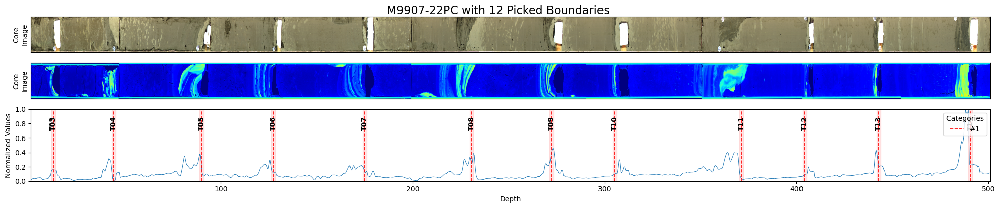

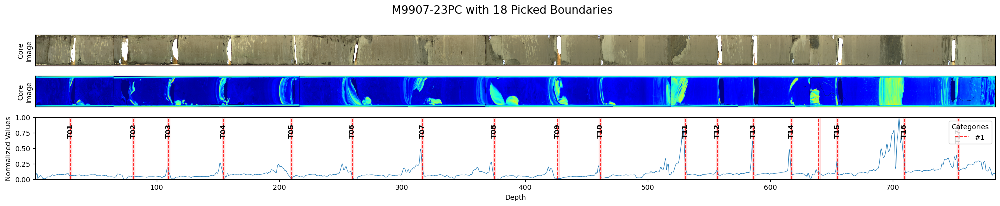

In [23]:
%matplotlib inline

# Define paths to the CSV files of picked depths
pickeddepth_a_csv = f'pickeddepth/{CORE_A}_pickeddepth.csv'
pickeddepth_b_csv = f'pickeddepth/{CORE_B}_pickeddepth.csv'

# Load picked depths and categories directly
if os.path.exists(pickeddepth_a_csv):
    picked_data_a = pd.read_csv(pickeddepth_a_csv)
else:
    print(f"Warning: {pickeddepth_a_csv} not found.")
    picked_data_a = pd.DataFrame()

if os.path.exists(pickeddepth_b_csv):
    picked_data_b = pd.read_csv(pickeddepth_b_csv)
else:
    print(f"Warning: {pickeddepth_b_csv} not found.")
    picked_data_b = pd.DataFrame()

# Extract category 1 picked depths and interpreted bed names for both cores
cat1_data_a = picked_data_a[picked_data_a['category'] == 1]
print(f"Loaded {len(cat1_data_a)} picked depths from {CORE_A}")

cat1_data_b = picked_data_b[picked_data_b['category'] == 1]
print(f"Loaded {len(cat1_data_b)} picked depths from {CORE_B}")

picked_depths_a_cat1 = cat1_data_a['picked_depths_cm'].values.tolist()
picked_depths_b_cat1 = cat1_data_b['picked_depths_cm'].values.tolist()
picked_categories_a_cat1 = [1] * len(picked_depths_a_cat1)
picked_categories_b_cat1 = [1] * len(picked_depths_b_cat1)
picked_uncertainty_a_cat1 = [1] * len(picked_depths_a_cat1)
picked_uncertainty_b_cat1 = [1] * len(picked_depths_b_cat1)

interpreted_bed_a = cat1_data_a['interpreted_bed'].fillna('').values.tolist()
interpreted_bed_b = cat1_data_b['interpreted_bed'].fillna('').values.tolist()

# Plot both cores with interpreted bed names (category 1 only)
is_multilog = log_a.ndim > 1 and log_a.shape[1] > 1
fig_a_beds, ax_a_beds = plot_core_data(
    # Input data
    md_a,                                           # depth array
    log_a,                                          # log data array
    f"{CORE_A}",                                    # core name
    # Image data
    core_img_1=rgb_img_a,                           # RGB image array
    core_img_2=ct_img_a,                            # CT scan image array
    # Data configuration
    available_columns=available_columns_a,          # available data columns
    is_multilog=is_multilog,                        # multi-column log flag
    # Picked depth data
    picked_depths=picked_depths_a_cat1,             # picked depth values (category 1 only)
    picked_categories=picked_categories_a_cat1,     # picked categories (category 1 only)
    picked_uncertainties=picked_uncertainty_a_cat1, # uncertainty values (category 1 only)
    # Visualization settings
    figsize=(20, 4),                                # figure size (width, height)
    show_interpreted_bed_name=interpreted_bed_a     # show interpreted bed names
)

is_multilog = log_b.ndim > 1 and log_b.shape[1] > 1
fig_b_beds, ax_b_beds = plot_core_data(
    # Input data
    md_b,                                           # depth array
    log_b,                                          # log data array
    f"{CORE_B}",                                    # core name
    # Image data
    core_img_1=rgb_img_b,                           # RGB image array
    core_img_2=ct_img_b,                            # CT scan image array
    # Data configuration
    available_columns=available_columns_b,          # available data columns
    is_multilog=is_multilog,                        # multi-column log flag
    # Picked depth data
    picked_depths=picked_depths_b_cat1,             # picked depth values (category 1 only)
    picked_categories=picked_categories_b_cat1,     # picked categories (category 1 only)
    picked_uncertainties=picked_uncertainty_b_cat1, # uncertainty values (category 1 only)
    # Visualization settings
    figsize=(20, 4),                                # figure size (width, height)
    show_interpreted_bed_name=interpreted_bed_b     # show interpreted bed names
)

plt.tight_layout()
plt.show()


#### extract ages

In [ ]:
# Load age constraints for both cores
consider_adjacent_core = True

# Goldfinger2012 age values
# data_columns = {
#     'age': 'calib502_agebp',
#     'pos_error': 'calib502_2sigma_pos', 
#     'neg_error': 'calib502_2sigma_neg',
#     'min_depth': 'mindepth_cm',
#     'max_depth': 'maxdepth_cm',
#     'in_sequence': 'in_sequence',
#     'core': 'core',
#     'interpreted_bed': 'interpreted_bed'
# }

data_columns = {
    'age': 'calib810_agebp',
    'pos_error': 'calib810_2sigma_pos', 
    'neg_error': 'calib810_2sigma_neg',
    'min_depth': 'mindepth_cm',
    'max_depth': 'maxdepth_cm',
    'in_sequence': 'in_sequence',
    'core': 'core',
    'interpreted_bed': 'interpreted_bed'
}

# Configuration
age_base_path = '/Users/larryslai/Library/CloudStorage/Dropbox/My Documents/University of Texas Austin/(Project) NWP turbidites/Cascadia_core_data/Age constraints/Goldfinger2012'

# Load age constraints for both cores
age_data_a = load_core_age_constraints(CORE_A, age_base_path, consider_adjacent_core, data_columns)
age_data_b = load_core_age_constraints(CORE_B, age_base_path, consider_adjacent_core, data_columns)

uncertainty_method='MonteCarlo'   # 'MonteCarlo', 'Linear', or 'Gaussian'

Loaded 4 age constraints from M9907-23PC_age.csv
Loaded 1 age constraints from M9907-23TC_age.csv


In [25]:
# Calculate interpolated ages for Core A using the function
pickeddepth_ages_a = calculate_interpolated_ages(
    # Input data
    picked_depths=picked_depths_a_cat1,                             # depths to interpolate ages for
    age_constraints_depths=age_data_a['depths'],                         # age constraint depths
    age_constraints_ages=age_data_a['ages'],                             # age constraint ages
    age_constraints_pos_errors=age_data_a['pos_errors'],                 # positive errors
    age_constraints_neg_errors=age_data_a['neg_errors'],                 # negative errors
    age_constraints_in_sequence_flags=age_data_a['in_sequence_flags'],   # in-sequence flags
    age_constraint_source_core=age_data_a['core'],                       # source core for each constraint
    # Core boundaries
    top_bottom=True,                                                     # include top and bottom depths/ages
    top_depth=0.0,                                                       # top of core depth
    bottom_depth=md_a[-1],                                               # max depth of core a
    top_age=0,                                                           # default age at top of core
    top_age_pos_error=75,                                                # default positive uncertainty of top age
    top_age_neg_error=75,                                                # default negative uncertainty of top age
    # Uncertainty calculation
    uncertainty_method=uncertainty_method,                               # uncertainty calculation method: 'MonteCarlo', 'Linear', or 'Gaussian'
    n_monte_carlo=10000,                                                 # number of Monte Carlo iterations
    # Visualization and output
    show_plot=True,                                                      # display plot
    core_name=CORE_A,                                                    # core name for plot title
    export_csv=True,                                                     # export results to CSV
    csv_filename=f'pickeddepth_ages/{CORE_A}_pickeddepth_ages_{uncertainty_method}.csv',                         # CSV filename for results
    mute_mode=False
)

# Print the age constraint data for Core A
print("\nAge Constraints for Core A:")
if len(age_data_a['depths']) > 0:
    for i in range(len(age_data_a['depths'])):
        depth_val = age_data_a['depths'].iloc[i] if isinstance(age_data_a['depths'], pd.Series) else age_data_a['depths'][i]
        age_val = age_data_a['ages'][i]
        pos_err_val = age_data_a['pos_errors'][i]
        neg_err_val = age_data_a['neg_errors'][i]
        in_seq = age_data_a['in_sequence_flags'][i]
        
        # Add source core and interpreted bed info if they exist
        source_core_info = f", Source Core: {age_data_a['core'][i]}" if i < len(age_data_a['core']) else ""
        bed_info = f", Interpreted Bed: {age_data_a['interpreted_bed'][i]}" if i < len(age_data_a['interpreted_bed']) else ""
        
        print(f"Depth: {depth_val:.2f} cm, Age: {age_val:.1f} years BP (+{pos_err_val:.1f} ; -{neg_err_val:.1f}), In Sequence: {in_seq}{source_core_info}{bed_info}")
else:
    print(f"No age constraints available in {CORE_A}")

# Print the interpolated ages
print(f"\nEstimated Ages for picked depths in {CORE_A}:")
for i, depth in enumerate(pickeddepth_ages_a['depths']):
    print(f"Depth: {depth:.2f} cm, Age: {pickeddepth_ages_a['ages'][i]:.1f} years BP (+{pickeddepth_ages_a['pos_uncertainties'][i]:.1f} ; -{pickeddepth_ages_a['neg_uncertainties'][i]:.1f})")

No age constraints provided. Cannot calculate interpolated ages.
Exported empty age results (no constraints) to pickeddepth_ages/M9907-22PC_pickeddepth_ages_MonteCarlo.csv

Age Constraints for Core A:
No age constraints available in M9907-22PC

Estimated Ages for picked depths in M9907-22PC:
Depth: 0.00 cm, Age: 0.0 years BP (+75.0 ; -75.0)
Depth: 12.45 cm, Age: nan years BP (+nan ; -nan)
Depth: 44.00 cm, Age: nan years BP (+nan ; -nan)
Depth: 89.89 cm, Age: nan years BP (+nan ; -nan)
Depth: 127.22 cm, Age: nan years BP (+nan ; -nan)
Depth: 174.95 cm, Age: nan years BP (+nan ; -nan)
Depth: 230.57 cm, Age: nan years BP (+nan ; -nan)
Depth: 272.35 cm, Age: nan years BP (+nan ; -nan)
Depth: 305.21 cm, Age: nan years BP (+nan ; -nan)
Depth: 371.32 cm, Age: nan years BP (+nan ; -nan)
Depth: 404.24 cm, Age: nan years BP (+nan ; -nan)
Depth: 442.78 cm, Age: nan years BP (+nan ; -nan)
Depth: 490.56 cm, Age: nan years BP (+nan ; -nan)
Depth: 501.01 cm, Age: nan years BP (+nan ; -nan)


In [37]:
pickeddepth_ages_a

{'depths': [0.0,
  12.44542759067474,
  43.99871766061551,
  89.89075477319513,
  127.21962856522217,
  174.9493514075565,
  230.5675028986644,
  272.3466950845567,
  305.21261781860795,
  371.3191979584895,
  404.2352268238293,
  442.77652101738994,
  490.55634999101267,
  501.01212],
 'ages': [0, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
 'pos_uncertainties': [75,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan],
 'neg_uncertainties': [75,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan,
  nan],
 'uncertainty_method': 'MonteCarlo'}

Running Monte Carlo simulation with 10000 iterations...
Exported interpolated/extrapolated ages (MonteCarlo method) to pickeddepth_ages/M9907-23PC_pickeddepth_ages_MonteCarlo.csv


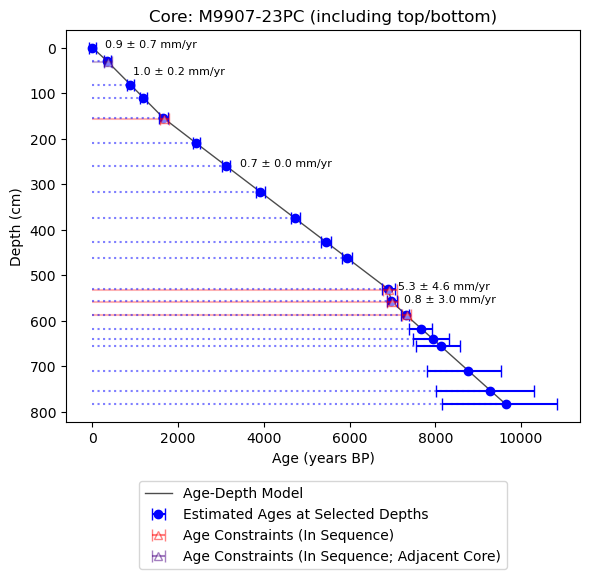


Age Constraints for Core B:
Depth: 31.63 cm, Age: 363.0 years BP (+90.0 ; -85.0), In Sequence: True, Source Core: 23TC, Interpreted Bed: T01
Depth: 156.47 cm, Age: 1675.0 years BP (+106.0 ; -101.0), In Sequence: True, Source Core: 23PC, Interpreted Bed: T04
Depth: 532.79 cm, Age: 6931.0 years BP (+168.0 ; -149.0), In Sequence: True, Source Core: 23PC, Interpreted Bed: T11?
Depth: 558.91 cm, Age: 6980.0 years BP (+160.0 ; -114.0), In Sequence: True, Source Core: 23PC, Interpreted Bed: T12
Depth: 588.29 cm, Age: 7329.0 years BP (+100.0 ; -113.0), In Sequence: True, Source Core: 23PC, Interpreted Bed: T13

Estimated Ages for picked depths in M9907-23PC:
Depth: 0.00 cm, Age: 0.0 years BP (+75.0 ; -75.0)
Depth: 29.63 cm, Age: 340.0 years BP (+81.4 ; -76.3)
Depth: 81.05 cm, Age: 882.4 years BP (+75.8 ; -72.1)
Depth: 109.62 cm, Age: 1182.6 years BP (+79.0 ; -75.7)
Depth: 154.47 cm, Age: 1654.0 years BP (+99.4 ; -94.6)
Depth: 210.01 cm, Age: 2422.8 years BP (+93.3 ; -88.3)
Depth: 259.39 cm, A

In [26]:
# Calculate interpolated ages for Core B using the function
pickeddepth_ages_b = calculate_interpolated_ages(
    # Input data
    picked_depths=picked_depths_b_cat1,                             # depths to interpolate ages for
    age_constraints_depths=age_data_b['depths'],                         # age constraint depths
    age_constraints_ages=age_data_b['ages'],                             # age constraint ages
    age_constraints_pos_errors=age_data_b['pos_errors'],                 # positive errors
    age_constraints_neg_errors=age_data_b['neg_errors'],                 # negative errors
    age_constraints_in_sequence_flags=age_data_b['in_sequence_flags'],   # in-sequence flags
    age_constraint_source_core=age_data_b['core'],                       # source core for each constraint
    # Core boundaries
    top_bottom=True,                                                     # include top and bottom depths/ages
    top_depth=0.0,                                                       # top of core depth
    bottom_depth=md_b[-1],                                               # max depth of core b
    top_age=0,                                                           # default age at top of core
    top_age_pos_error=75,                                                # default positive uncertainty of top age
    top_age_neg_error=75,                                                # default negative uncertainty of top age
    # Uncertainty calculation
    uncertainty_method=uncertainty_method,                               # uncertainty calculation method: 'MonteCarlo', 'Linear', or 'Gaussian'
    n_monte_carlo=10000,                                                 # number of Monte Carlo sampling iterations
    # Visualization and output
    show_plot=True,                                                      # display plot
    core_name=CORE_B,                                                    # core name for plot title
    export_csv=True,                                                     # export results to CSV
    csv_filename=f'pickeddepth_ages/{CORE_B}_pickeddepth_ages_{uncertainty_method}.csv',                         # CSV filename for results
    mute_mode=False
)

# Print the age constraint data for Core B
print("\nAge Constraints for Core B:")
if len(age_data_b['depths']) > 0:
    for i in range(len(age_data_b['depths'])):
        depth_val = age_data_b['depths'].iloc[i] if isinstance(age_data_b['depths'], pd.Series) else age_data_b['depths'][i]
        age_val = age_data_b['ages'][i]
        pos_err_val = age_data_b['pos_errors'][i]
        neg_err_val = age_data_b['neg_errors'][i]
        in_seq = age_data_b['in_sequence_flags'][i]
        
        # Add source core and interpreted bed info if they exist
        source_core_info = f", Source Core: {age_data_b['core'][i]}" if i < len(age_data_b['core']) else ""
        bed_info = f", Interpreted Bed: {age_data_b['interpreted_bed'][i]}" if i < len(age_data_b['interpreted_bed']) else ""
        
        print(f"Depth: {depth_val:.2f} cm, Age: {age_val:.1f} years BP (+{pos_err_val:.1f} ; -{neg_err_val:.1f}), In Sequence: {in_seq}{source_core_info}{bed_info}")
else:
    print(f"No age constraints available in {CORE_B}")

print(f"\nEstimated Ages for picked depths in {CORE_B}:")
for i, depth in enumerate(pickeddepth_ages_b['depths']):
    print(f"Depth: {depth:.2f} cm, Age: {pickeddepth_ages_b['ages'][i]:.1f} years BP (+{pickeddepth_ages_b['pos_uncertainties'][i]:.1f} ; -{pickeddepth_ages_b['neg_uncertainties'][i]:.1f})")

In [27]:
# # Load estimated boundary age data for both cores from CSV files using the imported function
# cores = [CORE_A, CORE_B]
# pickeddepth_ages = {}

# for core in cores:
#     core_age_csv = f"pickeddepth_ages/{core}_pickeddepth_ages_{uncertainty_method}.csv"
#     pickeddepth_ages[core] = load_pickeddepth_ages_from_csv(core_age_csv)

# # Assign to individual variables for backward compatibility
# if CORE_A in pickeddepth_ages:
#     pickeddepth_ages_a = pickeddepth_ages[CORE_A]
# if CORE_B in pickeddepth_ages:
#     pickeddepth_ages_b = pickeddepth_ages[CORE_B]


#### Find out all segment pairs among boundaries

In [28]:
# Define file names for age consideration or not

# Check if the last age in either core is NaN to determine age consideration
last_age_a = pickeddepth_ages_a['ages'][-1] if len(pickeddepth_ages_a['ages']) > 0 else float('nan')
last_age_b = pickeddepth_ages_b['ages'][-1] if len(pickeddepth_ages_b['ages']) > 0 else float('nan')

age_consideration = not (pd.isna(last_age_a) or pd.isna(last_age_b))
# age_consideration = False

restricted_age_correlation=True

shortest_path_search=True

if age_consideration:
    if restricted_age_correlation:
        YES_NO_AGE = 'restricted_age'
    else:
        YES_NO_AGE = 'loose_age'
else:
    YES_NO_AGE = 'no_age'

if shortest_path_search:
    SEARCH_METHOD = 'optimal'
else:
    SEARCH_METHOD = 'random'

# Define whether to use independent DTW or not for multidimensional DTW analysis
# If False (default): it performs dependent multidimensional DTW analysis. 
# If True: it performs independent multidimensional DTW analysis.
independent_dtw=False 

# For multidimensional DTW, choose DTW method:
# If False (default): Conventional multidimensional DTW approach
# If True: PCA-based dependent DTW approach (perform 1D DTW on the PC1 axis)
pca_for_dependent_dtw=False 

Starting comprehensive DTW analysis with integrated age correlation...

Log A depth values: [0.0, 12.44542759067474, 43.99871766061551, 89.89075477319513, 127.21962856522217, 174.9493514075565, 230.5675028986644, 272.3466950845567, 305.21261781860795, 371.3191979584895, 404.2352268238293, 442.77652101738994, 490.55634999101267, 501.01212]
Log A depth boundaries: [0, 46, 172, 356, 505, 696, 919, 1086, 1218, 1483, 1615, 1769, 1960, 2002]

Log B depth values: [0.0, 29.62770108, 81.04964565, 109.6173926, 154.4690131, 210.0126177, 259.3940089, 316.7538349, 375.2974395, 426.7193841, 461.2250125, 530.7876052, 556.9066882, 586.2906565, 617.3070675, 639.7531544, 655.0370279, 709.3157472, 753.207921, 783.49744]
Log B depth boundaries: [0, 115, 320, 435, 614, 837, 1034, 1264, 1498, 1704, 1842, 2121, 2225, 2343, 2467, 2557, 2618, 2835, 3011, 3132]
Generated 27 possible segments for log A
Generated 39 possible segments for log B
Calculating full DTW distance matrix...
Found 773 valid segment pairs 

Calculating DTW for segment pairs...: 100%|██████████| 773/773 [00:00<00:00, 5537.61it/s]


Found 773 valid segment pairs based on DTW distance

=== CONNECTIVITY CHECK ===


Complete paths exist

=== DEAD-END FILTERING ===
Retained 773 segments after filtering
Generated DTW matrix with paths of all segment pairs at: outputs/M9907-22PC_M9907-23PC/hiresMS/SegmentPair_DTW_matrix_no_age_optimal.png

Skipping GIF animation creation as creategif=False

Displaying DTW matrix visualization from: outputs/M9907-22PC_M9907-23PC/hiresMS/SegmentPair_DTW_matrix_no_age_optimal.png


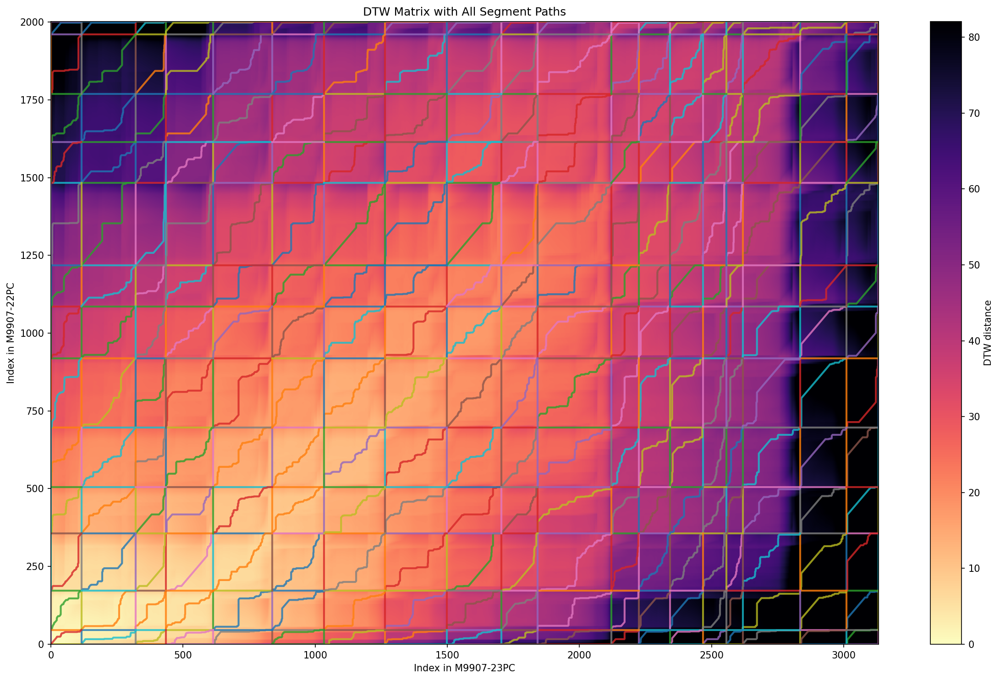

In [29]:
%matplotlib inline
    
# Run comprehensive DTW analysis
dtw_results, valid_dtw_pairs, segments_a, segments_b, depth_boundaries_a, depth_boundaries_b, dtw_distance_matrix_full = run_comprehensive_dtw_analysis(
    # Input data
    log_a,                                                      # Core A log data
    log_b,                                                      # Core B log data
    md_a,                                                       # Core A measured depth
    md_b,                                                       # Core B measured depth
    picked_depths_a=picked_depths_a_cat1,                         # Selected depths for core A
    picked_depths_b=picked_depths_b_cat1,                         # Selected depths for core B
    core_a_name=CORE_A,                                        # Name identifier for core A
    core_b_name=CORE_B,                                        # Name identifier for core B
    # Analysis parameters
    top_bottom=True,                                            # Include top and bottom boundaries
    top_depth=0.0,                                              # Starting depth for analysis
    independent_dtw=independent_dtw,                            # Use independent DTW if True
    exclude_deadend=True,                                       # Exclude dead-end segments
    pca_for_dependent_dtw=pca_for_dependent_dtw,                # Use PCA for dependent DTW
    # Age constraints
    age_consideration=age_consideration,                        # Include age constraints
    ages_a=pickeddepth_ages_a,                                  # Age data for core A depths
    ages_b=pickeddepth_ages_b,                                  # Age data for core B depths
    restricted_age_correlation=restricted_age_correlation,      # Use strict age correlation
    all_constraint_ages_a=age_data_a['in_sequence_ages'],      # All age constraints for core A
    all_constraint_ages_b=age_data_b['in_sequence_ages'],      # All age constraints for core B
    all_constraint_depths_a=age_data_a['in_sequence_depths'],  # All depth constraints for core A
    all_constraint_depths_b=age_data_b['in_sequence_depths'],  # All depth constraints for core B
    all_constraint_pos_errors_a=age_data_a['in_sequence_pos_errors'], # Positive age errors for core A
    all_constraint_pos_errors_b=age_data_b['in_sequence_pos_errors'], # Positive age errors for core B
    all_constraint_neg_errors_a=age_data_a['in_sequence_neg_errors'], # Negative age errors for core A
    all_constraint_neg_errors_b=age_data_b['in_sequence_neg_errors'], # Negative age errors for core B
    age_constraint_a_source_cores=age_data_a['core'],          # Source cores for age constraints A
    age_constraint_b_source_cores=age_data_b['core'],          # Source cores for age constraints B
    # Visualization
    visualize_pairs=True,                                       # Create pair visualizations
    visualize_segment_labels=False,                             # Show segment labels in plots
    create_dtw_matrix=True,                                     # Generate DTW distance matrix
    dtwmatrix_output_filename=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/SegmentPair_DTW_matrix_{YES_NO_AGE}_{SEARCH_METHOD}.png', # Matrix plot filename
    creategif=False,                                             # Create animated GIF
    gif_output_filename=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/SegmentPair_DTW_animation_{YES_NO_AGE}_{SEARCH_METHOD}.gif', # GIF filename
    max_frames=50,                                              # Maximum frames in animation
    color_interval_size=5,                                      # Color coding interval size
    keep_frames=True,                                           # Save individual frames
    # Debug and processing
    debug=False                                                 # Enable debug output
)

In [30]:
diagnostic_result = diagnose_chain_breaks(
    # Input data
    valid_dtw_pairs,                                        # Valid DTW segment pairs from analysis
    segments_a,                                             # Segment definitions for core A
    segments_b,                                             # Segment definitions for core Bss
    depth_boundaries_a,                                     # Depth boundaries for core A segments
    depth_boundaries_b                                      # Depth boundaries for core B segments
)

=== CHAIN BREAK DIAGNOSTIC ===

=== SEGMENT INVENTORY & CONNECTIVITY ===
Core A max depth: 2002, Core B max depth: 3132
Total valid segment pairs: 773
Top segments (start at 0,0): [(2, 1), (1, 2), (2, 2)]
Bottom segments (end at max): [(26, 39), (26, 38), (27, 38)]
Dead ends (no successors): 0 - []
Orphans (no predecessors): 0 - []

=== DETAILED SEGMENT ANALYSIS ===
  1. Segment ( 1, 2): A[   0.0:   0.0] B[   0.0: 115.0] (A_len=  1, B_len=116) pred:0 succ:3 TOP
  2. Segment ( 1, 4): A[   0.0:   0.0] B[ 115.0: 320.0] (A_len=  1, B_len=206) pred:1 succ:3 MIDDLE
  3. Segment ( 1, 6): A[   0.0:   0.0] B[ 320.0: 435.0] (A_len=  1, B_len=116) pred:1 succ:3 MIDDLE
  4. Segment ( 1, 8): A[   0.0:   0.0] B[ 435.0: 614.0] (A_len=  1, B_len=180) pred:1 succ:3 MIDDLE
  5. Segment ( 1,10): A[   0.0:   0.0] B[ 614.0: 837.0] (A_len=  1, B_len=224) pred:1 succ:3 MIDDLE
  6. Segment ( 1,12): A[   0.0:   0.0] B[ 837.0:1034.0] (A_len=  1, B_len=198) pred:1 succ:3 MIDDLE
  7. Segment ( 1,14): A[   0.0:   

<hr>

## Search complete DTW paths

In [31]:
complete_path_search_result = find_complete_core_paths(
    # Input data
    valid_dtw_pairs,                                                                # Valid DTW segment pairs from analysis
    segments_a,                                                                     # Segment definitions for core A
    segments_b,                                                                     # Segment definitions for core B
    log_a,                                                                          # Log data for core A
    log_b,                                                                          # Log data for core B
    depth_boundaries_a,                                                             # Depth boundaries for core A segments
    depth_boundaries_b,                                                             # Depth boundaries for core B segments
    dtw_results,                                                                    # DTW analysis results
    dtw_distance_matrix_full,                                                       # Full DTW distance matrix
    # Output settings
    output_csv=f"outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/mappings_{YES_NO_AGE}_{SEARCH_METHOD}.csv",     # Output CSV filename for mappings
    # Search parameters
    start_from_top_only=True,                                                       # Start path search from top segments only
    shortest_path_search=shortest_path_search,                                      # Use shortest path search algorithm
    shortest_path_level=2,                                                          # Path level preference (higher = more segments)
    max_search_path=100000,                                                         # Maximum paths per segment pair to avoid memory issues
    # Processing settings
    batch_size=1000,                                                                # Processing batch size
    n_jobs=-1,                                                                      # Number of CPU cores (-1 uses all available)
    debug=False,                                                                    # Enable debug output,
    pca_for_dependent_dtw=pca_for_dependent_dtw
)

Setting up boundary constraints...
Identified 3 valid segments at the top of both cores
Valid top segments (1-based indices): [(2, 1), (2, 2), (1, 2)]
Identified 3 valid segments at the bottom of both cores
Valid bottom segments (1-based indices): [(26, 39), (26, 38), (27, 38)]

=== COMPLETE PATH COMPUTATION ===
Viable segments (excluding dead ends and orphans): 773
Viable top segments: 3
Viable bottom segments: 3
  Paths from top segment (2,1): 35330137025
  Paths from top segment (1,2): 60592003085
  Paths from top segment (2,2): 19403906105
Total complete paths: 115326046215

Building segment relationships...
Using 3 valid top segments for path starting points
Identified 773 segments in processing order
Created temporary directory for databases: /var/folders/nb/sjnrf0bd5rd3p_tlpft11hvc0000gn/T/tmp_41ta_nn
Initializing shared database with top segments...
Processing 773 segments in 773 groups (1 segment per group for complete enumeration)


Processing segment groups: 100%|██████████| 773/773 [00:31<00:00, 24.25it/s, segment=773/773, intermediate_paths=100000/100000, complete_paths_found=6400, duplicates_removed=9]


Performing final deduplication on complete database...
Processing complete. Found 6400 unique complete paths after removing 9 duplicates.

=== Computing Metrics and Generating CSV Output ===
Processing 6400 paths in 7 batches


Processing batches: 100%|██████████| 7/7 [00:29<00:00,  4.22s/it]


Final Results:
  Total unique complete paths written: 6400
  Total duplicates removed during processing: 9
  Deduplication efficiency: 0.14%
Cleaning up temporary databases...
Cleanup complete.
All complete core-to-core paths saved to outputs/M9907-22PC_M9907-23PC/hiresMS/mappings_no_age_optimal.csv


Created fresh frame directory: outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_correlation_frames
Created fresh frame directory: outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_matrix_frames
Found 6400 mappings in CSV
Selected 50 representative mappings for visualization
Starting parallel visualization processing...


Processing batches: 100%|██████████| 3/3 [00:29<00:00,  9.74s/it]


Successfully visualized 50 out of 50 mappings

Creating GIFs from frames...


Processing frames for outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_correlation_mappings_no_age_optimal.gif: 100%|██████████| 49/49 [00:02<00:00, 24.10it/s]
Processing frames for outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_matrix_mappings_no_age_optimal.gif: 100%|██████████| 49/49 [00:02<00:00, 17.19it/s]


Created GIF with 50 frames at outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_correlation_mappings_no_age_optimal.gif
Created GIF with 50 frames at outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_matrix_mappings_no_age_optimal.gif
Cleaning up frame folders as keep_frames=False...
Removed frame directory: outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_correlation_frames
Removed frame directory: outputs/M9907-22PC_M9907-23PC/hiresMS/CombinedDTW_matrix_frames
DTW Correlation Mappings GIF:


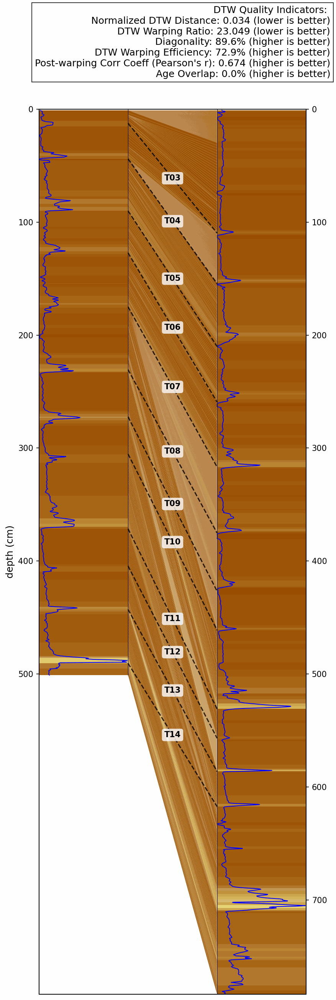

DTW Matrix Mappings GIF:


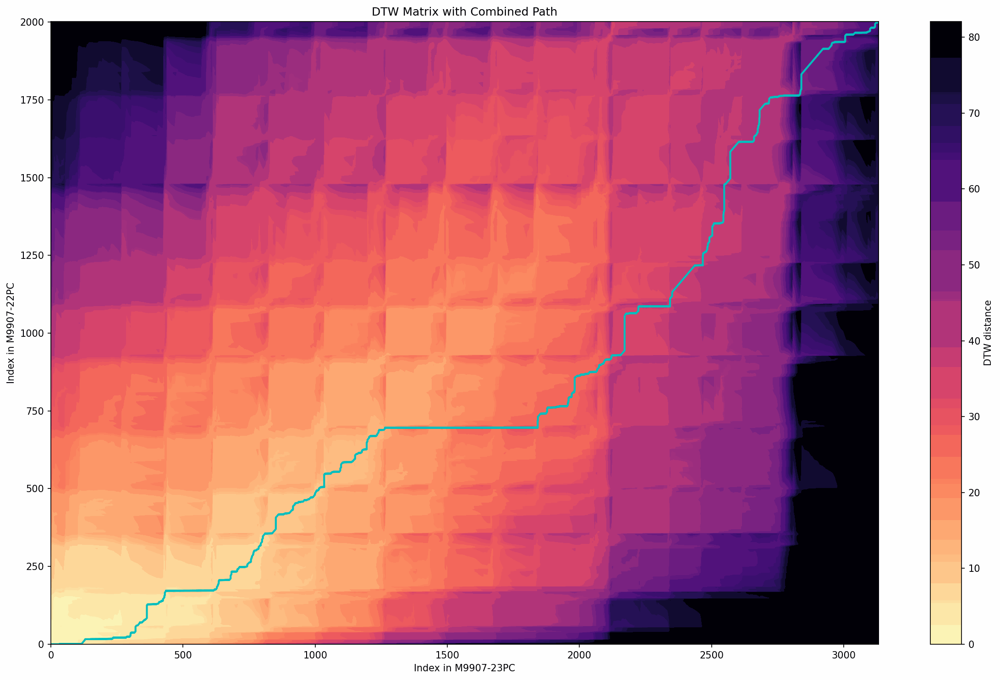

In [32]:
%matplotlib inline

correlation_gif_name=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/CombinedDTW_correlation_mappings_{YES_NO_AGE}_{SEARCH_METHOD}.gif'
matrix_gif_name=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/CombinedDTW_matrix_mappings_{YES_NO_AGE}_{SEARCH_METHOD}.gif'

# 1. First, read all available mappings from a CSV (assuming it was created by find_all_sequential_mappings)
sequential_mappings_csv = f"outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/mappings_{YES_NO_AGE}_{SEARCH_METHOD}.csv"

# 3. Visualize a representative subset of the mappings
visualize_dtw_results_from_csv(
    # Input data
    sequential_mappings_csv,                                                        # CSV file with sequential mappings
    log_a,                                                                          # Log data for core A
    log_b,                                                                          # Log data for core B
    md_a,                                                                           # Measured depth data for core A
    md_b,                                                                           # Measured depth data for core B
    dtw_results,                                                                    # DTW analysis results
    valid_dtw_pairs,                                                                # Valid DTW segment pairs
    segments_a,                                                                     # Segment definitions for core A
    segments_b,                                                                     # Segment definitions for core B
    depth_boundaries_a,                                                             # Depth boundaries for core A segments
    depth_boundaries_b,                                                             # Depth boundaries for core B segments
    dtw_distance_matrix_full,                                                       # Full DTW distance matrix
    # Core identifiers
    core_a_name=CORE_A,                                                             # Name identifier for core A
    core_b_name=CORE_B,                                                             # Name identifier for core B
    # Visualization settings
    color_interval_size=10,                                                         # Color interval size for visualization
    debug=False,                                                                    # Enable debug output
    visualize_pairs=False,                                                          # Show DTW pairs in visualization
    visualize_segment_labels=False,                                                 # Show segment labels in visualization
    mark_depths=False,                                                               # Mark depth points in visualization
    # GIF output settings
    creategif=True,                                                                 # Create animated GIF output
    correlation_gif_output_filename=correlation_gif_name,                          # Output filename for correlation GIF
    matrix_gif_output_filename=matrix_gif_name,                                    # Output filename for matrix GIF
    max_frames=50,                                                                  # Maximum number of frames in GIF
    keep_frames=False,                                                               # Keep individual frames after GIF creation
    # Age constraints
    mark_ages=age_consideration,                                                    # Mark age constraints in visualization
    ages_a=pickeddepth_ages_a,                                                      # Age data for core A
    ages_b=pickeddepth_ages_b,                                                      # Age data for core B
    all_constraint_depths_a=age_data_a['in_sequence_depths'],                       # Depth constraints for core A
    all_constraint_depths_b=age_data_b['in_sequence_depths'],                       # Depth constraints for core B
    all_constraint_ages_a=age_data_a['in_sequence_ages'],                           # Age constraints for core A
    all_constraint_ages_b=age_data_b['in_sequence_ages'],                           # Age constraints for core B
    all_constraint_pos_errors_a=age_data_a['in_sequence_pos_errors'],               # Positive age errors for core A
    all_constraint_pos_errors_b=age_data_b['in_sequence_pos_errors'],               # Positive age errors for core B
    all_constraint_neg_errors_a=age_data_a['in_sequence_neg_errors'],               # Negative age errors for core A
    all_constraint_neg_errors_b=age_data_b['in_sequence_neg_errors'],               # Negative age errors for core B
    age_constraint_a_source_cores=age_data_a['core'],                               # Source cores for age constraints A
    age_constraint_b_source_cores=age_data_b['core'],                                # Source cores for age constraints B
    # Interpreted bed correlation
    interpreted_bed_a=interpreted_bed_a,         # Interpreted bed name for Core A
    interpreted_bed_b=interpreted_bed_b          # Interpreted bed name for Core B
)

# Display the GIFs
print("DTW Correlation Mappings GIF:")
display(IPImage(correlation_gif_name))

print("DTW Matrix Mappings GIF:")
display(IPImage(matrix_gif_name))

Plotting paths:   0%|          | 0/6400 [00:00<?, ?it/s]

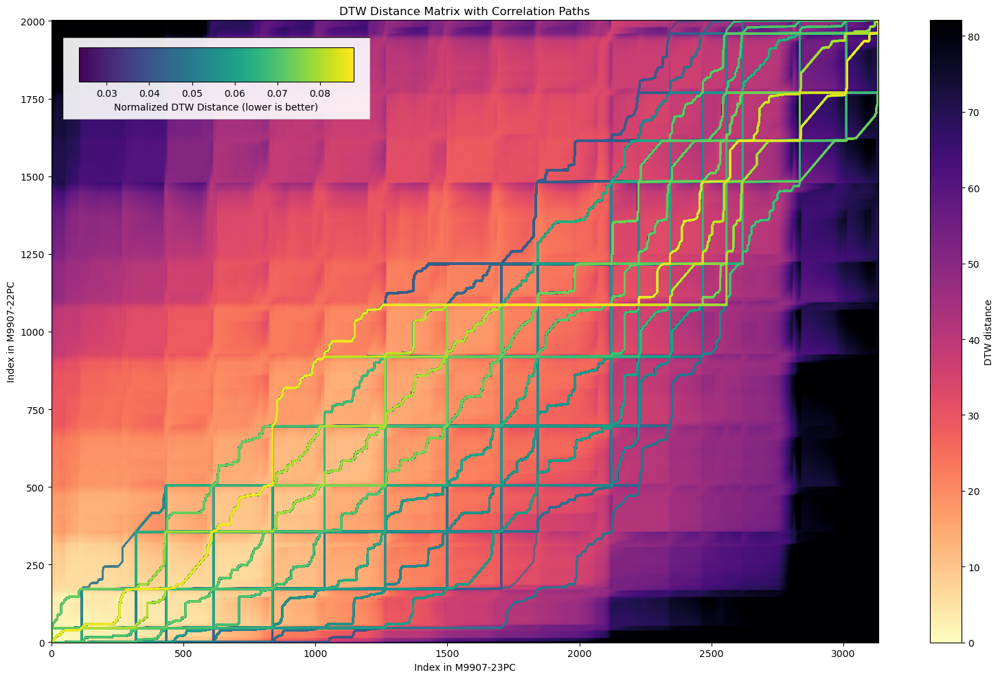

In [33]:
# Load the saved DTW results
sequential_mappings_csv = f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/mappings_{YES_NO_AGE}_{SEARCH_METHOD}.csv'
output_matrix_png_filename = f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/CombinedDTW_matrix_mappings_colored_{YES_NO_AGE}_{SEARCH_METHOD}.png'

%matplotlib inline

_ = plot_dtw_matrix_with_paths(
    # Input data
    dtw_distance_matrix_full,                                                       # Full DTW distance matrix
    sequential_mappings_csv=sequential_mappings_csv,                                # CSV file with sequential mappings
    # Core identifiers
    core_a_name=CORE_A,                                                             # Name identifier for core A
    core_b_name=CORE_B,                                                             # Name identifier for core B
    md_a=md_a,                                                                      # Metadata for core A
    md_b=md_b,                                                                      # Metadata for core B
    # Visualization settings
    mode='all_paths_colored',                                                       # Visualization mode
    color_metric='norm_dtw',                                                    # Metric used for coloring paths
                                                                                    # Available options: 'corr_coef', 'norm_dtw', 'dtw_ratio', 'perc_diag', 'dtw_warp_eff', 'perc_age_overlap', None (uses mapping_id)
    output_filename=output_matrix_png_filename,                                     # Output filename for the plot
    # Age constraint data
    age_constraint_a_depths=age_data_a['in_sequence_depths'] if age_consideration else None,  # Depth constraints for core A
    age_constraint_a_ages=age_data_a['in_sequence_ages'] if age_consideration else None,      # Age constraints for core A
    age_constraint_a_source_cores=age_data_a['core'] if age_consideration else None,          # Source cores for age constraints A
    age_constraint_b_depths=age_data_b['in_sequence_depths'] if age_consideration else None,  # Depth constraints for core B
    age_constraint_b_ages=age_data_b['in_sequence_ages'] if age_consideration else None,      # Age constraints for core B
    age_constraint_b_source_cores=age_data_b['core'] if age_consideration else None,          # Source cores for age constraints B
    # Performance settings
    n_jobs=-1                                                                       # Number of parallel jobs (-1 means use all processors)
)

In [34]:
### Find the best mapping ####
# Load the DTW results
sequential_mappings_csv = f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/mappings_{YES_NO_AGE}_{SEARCH_METHOD}.csv'

# Use custom metric weights
custom_weights = {
    'corr_coef': 1.0,
    'perc_diag': 0.0,
    'norm_dtw': 1.0,
    'dtw_ratio': 0.0,
    'perc_age_overlap': 0.0,
    'dtw_warp_eff': 0.0
}

# # To just find the best-scored mappings
# top_mapping_ids, top_mapping_pairs, top_mappings_df = find_best_mappings(
#     csv_file_path=sequential_mappings_csv,
#     top_n=10,
#     filter_shortest_dtw=True,
#     metric_weight=custom_weights
# )

### To find the best-scored mappings that comply the intepreted bed correlation
top_mapping_ids, top_mapping_pairs, top_mappings_df = find_best_mappings(
    csv_file_path=sequential_mappings_csv,
    metric_weight=custom_weights,
    picked_depths_a_cat1=picked_depths_a_cat1,
    picked_depths_b_cat1=picked_depths_b_cat1,
    interpreted_bed_a=interpreted_bed_a,
    interpreted_bed_b=interpreted_bed_b,
    valid_dtw_pairs=valid_dtw_pairs,
    segments_a=segments_a,
    segments_b=segments_b
)

Matching datums: ['T03', 'T04', 'T05', 'T06', 'T07', 'T08', 'T09', 'T10', 'T11', 'T12', 'T13', 'T14']
Datum matching correlations:
  Segment pair (4,8): [top:T03,bottom:T04]
  Segment pair (6,10): [top:T04,bottom:T05]
  Segment pair (8,12): [top:T05,bottom:T06]
  Segment pair (10,14): [top:T06,bottom:T07]
  Segment pair (12,16): [top:T07,bottom:T08]
  Segment pair (14,18): [top:T08,bottom:T09]
  Segment pair (16,20): [top:T09,bottom:T10]
  Segment pair (18,22): [top:T10,bottom:T11]
  Segment pair (20,24): [top:T11,bottom:T12]
  Segment pair (22,26): [top:T12,bottom:T13]
  Segment pair (24,28): [top:T13,bottom:T14]
No mappings found with matched datums. Searching for mappings with most matched segment pairs.

68/6400 mappings found with 7 matched segment pairs

Top 10 mappings by combined score:
Mapping ID 364: Combined Score=1.000
  correlation coefficient r=0.875
  norm_dtw=0.024
  valid_pairs_to_combine=[(1, 2), (1, 4), (1, 6), (1, 8), (2, 10), (4, 12), (6, 14), (8, 16), (10, 18), (1

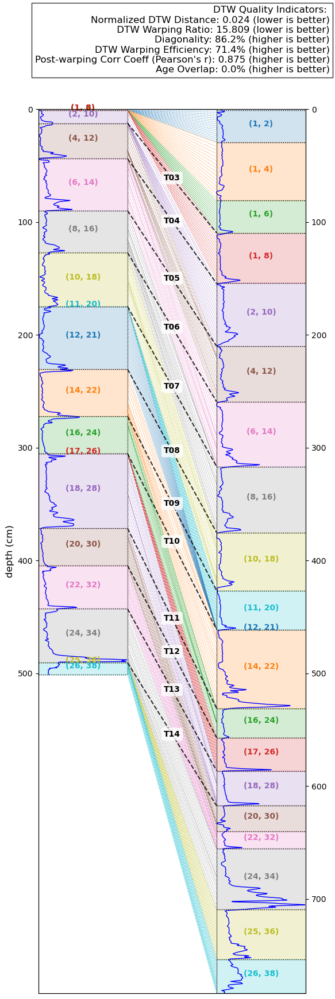

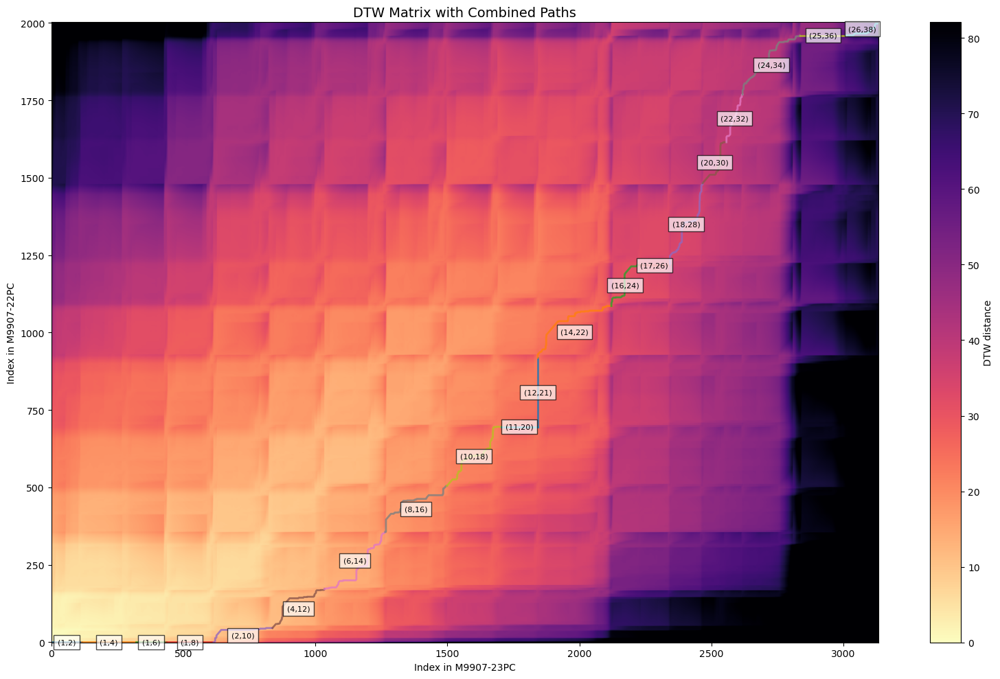

In [35]:
%matplotlib inline

visualize_pairs=True

if visualize_pairs:
    visualize_type='pairs'
    visualize_segment_labels=True
    mark_depths=True
else:
    visualize_type='fullpath'
    visualize_segment_labels=False
    mark_depths=False

# Visualize the combined segments
_, _, _, _ = visualize_combined_segments(
    # Input data
    log_a=log_a,                                # Core A log data
    log_b=log_b,                                # Core B log data
    md_a=md_a,                                  # Core A measured depths
    md_b=md_b,                                  # Core B measured depths
    dtw_results=dtw_results,                    # DTW alignment results
    valid_dtw_pairs=valid_dtw_pairs,            # Valid DTW pairs
    segments_a=segments_a,                      # Core A segments
    segments_b=segments_b,                      # Core B segments
    depth_boundaries_a=depth_boundaries_a,      # Core A depth boundaries
    depth_boundaries_b=depth_boundaries_b,      # Core B depth boundaries
    dtw_distance_matrix_full=dtw_distance_matrix_full,       # Full DTW distance matrix
    segment_pairs_to_combine=top_mapping_pairs[0],           # Valid pairs to combine
    # Visualization options
    color_interval_size=10,                     # Size of color intervals
    visualize_pairs=visualize_pairs,            # Whether to visualize pairs (True/False)
    visualize_segment_labels=visualize_segment_labels, # Whether to show segment labels (True/False)
    mark_depths=mark_depths,                    # Whether to mark depths (True/False)
    # Output paths
    correlation_save_path=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/CombinedDTW_correlation_{YES_NO_AGE}_{SEARCH_METHOD}_{top_mapping_ids[0]}_{visualize_type}.png',
    matrix_save_path=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/CombinedDTW_matrix_{YES_NO_AGE}_{SEARCH_METHOD}_{top_mapping_ids[0]}_{visualize_type}.png',
    # Age constraint parameters
    mark_ages=age_consideration,                # Whether to mark ages (True/False)
    ages_a=pickeddepth_ages_a if age_consideration else None, # Core A ages
    ages_b=pickeddepth_ages_b if age_consideration else None, # Core B ages
    all_constraint_ages_a=age_data_a['in_sequence_ages'] if age_consideration else None, # Core A constraint ages
    all_constraint_ages_b=age_data_b['in_sequence_ages'] if age_consideration else None, # Core B constraint ages
    all_constraint_depths_a=age_data_a['in_sequence_depths'] if age_consideration else None, # Core A constraint depths
    all_constraint_depths_b=age_data_b['in_sequence_depths'] if age_consideration else None, # Core B constraint depths
    all_constraint_pos_errors_a=age_data_a['in_sequence_pos_errors'] if age_consideration else None, # Core A positive errors
    all_constraint_pos_errors_b=age_data_b['in_sequence_pos_errors'] if age_consideration else None, # Core B positive errors
    all_constraint_neg_errors_a=age_data_a['in_sequence_neg_errors'] if age_consideration else None, # Core A negative errors
    all_constraint_neg_errors_b=age_data_b['in_sequence_neg_errors'] if age_consideration else None, # Core B negative errors
    age_constraint_a_source_cores=age_data_a['core'] if age_consideration else None, # Core A source cores
    age_constraint_b_source_cores=age_data_b['core'] if age_consideration else None, # Core B source cores
    # Core identifiers
    core_a_name=CORE_A,                         # Name of Core A
    core_b_name=CORE_B,                         # Name of Core B
    # Interpreted bed correlation
    interpreted_bed_a=interpreted_bed_a,         # Interpreted bed name for Core A
    interpreted_bed_b=interpreted_bed_b          # Interpreted bed name for Core B
)

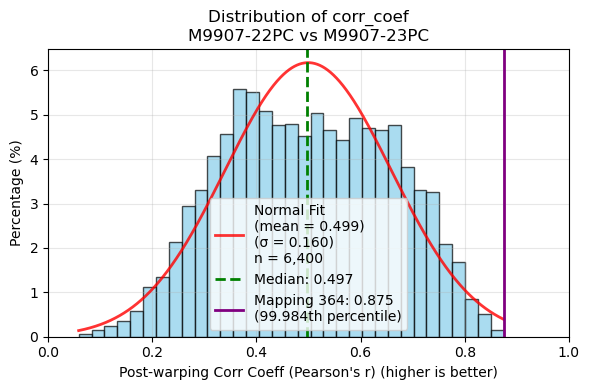

Summary Statistics for Post-warping Corr Coeff (Pearson's r) (higher is better):
Median: 0.497
Min: 0.059
Max: 0.875
Standard Deviation: 0.160
Number of data points: 6400

Distribution Fitting Results (normal):
Mean (μ): 0.49923 (Center of the distribution; magnitude indicates distance from zero)
Standard deviation (σ): 0.15985 (Width/spread of the distribution; larger magnitude increases variability)

Mapping ID 364 Post-warping Corr Coeff (Pearson's r) (higher is better): 0.875
Percentile: 99.984%


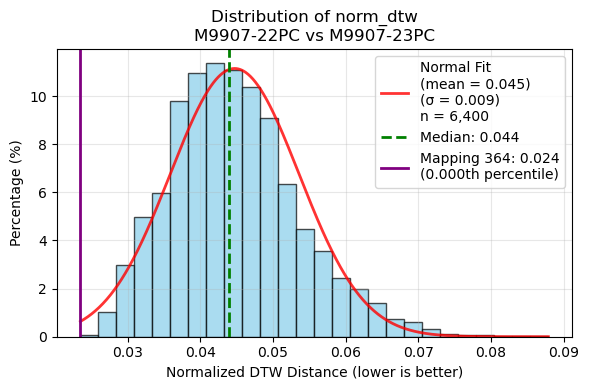

Summary Statistics for Normalized DTW Distance (lower is better):
Median: 0.044
Min: 0.024
Max: 0.088
Standard Deviation: 0.009
Number of data points: 6400

Distribution Fitting Results (normal):
Mean (μ): 0.04472 (Center of the distribution; magnitude indicates distance from zero)
Standard deviation (σ): 0.00886 (Width/spread of the distribution; larger magnitude increases variability)

Mapping ID 364 Normalized DTW Distance (lower is better): 0.024
Percentile: 0.000%


In [36]:
# Available quality indices: 'corr_coef', 'norm_dtw', 'dtw_ratio', 'perc_diag', 'dtw_warp_eff', 'perc_age_overlap'
# targeted_quality_index = 'corr_coef' 
targeted_quality_index = ['corr_coef', 'norm_dtw']  # Can be a single string or list of strings

# Handle both single index and multiple indices
if isinstance(targeted_quality_index, str):
    targeted_quality_index = [targeted_quality_index]

# Loop over all targeted quality indices
for quality_idx in targeted_quality_index:
    plot_correlation_distribution(
        # Input parameters
        csv_file=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/mappings_{YES_NO_AGE}_{SEARCH_METHOD}.csv',  # Path to mappings CSV file
        target_mapping_id=top_mapping_ids[0],                                             # ID of mapping to analyze
        quality_index=quality_idx,                                                        # Quality metric to plot
        # Core names
        core_a_name=CORE_A,                                                               # Core A name
        core_b_name=CORE_B,                                                               # Core B name
        # Histogram parameters
        bin_width=None,                                                                   # Bin width (auto if None)
        # Output parameters
        save_png=True,                                                                    # Whether to save plot as PNG
        png_filename=f'outputs/{CORE_A}_{CORE_B}/{"_".join(LOG_COLUMNS)}/{"r-values" if quality_idx == "corr_coef" else quality_idx}_distribution_{YES_NO_AGE}_{SEARCH_METHOD}.png',  # Output filename
        # Distribution fitting parameters
        pdf_method='normal',                                                              # PDF fitting method: 'KDE', 'skew-normal', or 'normal'
        kde_bandwidth=0.05,                                                               # Bandwidth for KDE method
        mute_mode=False                                                                   # Whether to suppress print statements
    )